# CRİME GEOGRAPHİCAL CLUSTERING

San Francisco Suç Veriseti Harita Tabanlı Coğrafik Kümeleme
projemizde San Francisco Crime
Dataset'ini kullanacağız.

Veri seti, 2003-2015 yılları arasında San
Francisco'da işlenen suçlardan
oluşmaktadır.
Veri setinde suçlarla ilgili pek çok
istatistiksel sütun vardır, ancak
kümeleme için yalnızca suç mahalli
coğrafi veri sütunlarını (Enlem ve
Boylam) kullanacağız.

Kümeleme için sadece sayısal
verileri kullanmayı amaçladığımız
için bu projede sınıflandırma için
K-means kümeleme algoritmasını
kullanabiliriz.K-MEANS sadece nümerik verilerde kullanılır.nümerik verlerle kümeleme yapar.Kategorşklerle yapamaz.

#### Proje adımlarımız aşağıdaki gibi olacak:

1. Import libraries, scale and prepare the dataset.

2. Kaç tane cluster kullanacağımıza karar vereceğiz, bunun için de Elbow
Metodunu kullanacağız (K değerini bulacağız).

3. Modelimizi oluşturup clustering işlemimizi K-Means Machine Learning algoritması kullanarak yapacağız.

4. Clustering sonuçlarımızı iyi bilinen harita altlık sistemlerinden biri
olan OpenStreetMap Coğrafi Komumlama sistemi üzerinde
kullanarak görüntüleyeceğiz.

5. Son olarak, ortaya çıkan coğrafi haritamızı herhangi bir web
sitesinde kolayca kullanılabilmesi için bir html dosyasına aktaracağız.


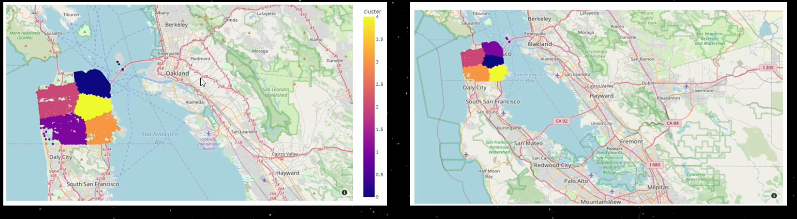

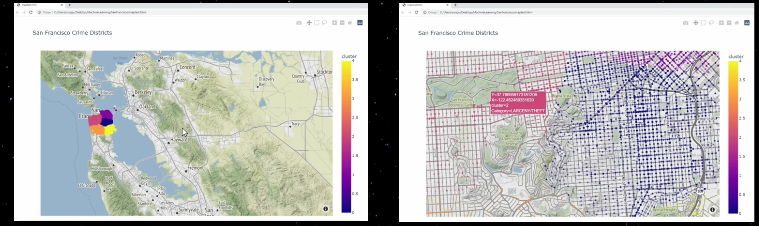

## Step 1 :import libraries and prepare the dataset

In [2]:
from sklearn.cluster import KMeans
import pandas as pd 
from sklearn.preprocessing import MinMaxScaler
# neden scale ederiz. Numerik değerleri aynı aralığa getiririz.
#kmeans aynı scale de olsun istiyor.

df = pd.read_csv('train.csv')
df.head()

# y : latitude (enlem)
# x : langitude (boylam)

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


#conda install plotly : harita işlemlerini yapmamızı sağlayan kütüphaneryi kurduk. anaconda prompt da çalışıtrıyoruz.

In [3]:
df = df.drop(['PdDistrict','Address','Resolution','Descript','DayOfWeek'],axis=1)

# BİZE SADECE ENLEM VE BOYLAM GEREK.

In [4]:
df.tail(5)

,Dates,Category,X,Y
878044,2003-01-06 00:15:00,ROBBERY,-122.459033,37.714056
878045,2003-01-06 00:01:00,LARCENY/THEFT,-122.447364,37.731948
878046,2003-01-06 00:01:00,LARCENY/THEFT,-122.403390,37.780266
878047,2003-01-06 00:01:00,VANDALISM,-122.390531,37.780607
878048,2003-01-06 00:01:00,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [6]:
df.isnull().sum()

Dates       0
Category    0
X           0
Y           0
dtype: int64

In [13]:
# sadece 2014 ylıına aitleri alalım. FİLTERİNG YAPALIM.
#date sütununu split et boşluğa göre ,ve sıfırıncı indeksi al.saatleri almadık.
f = lambda x: (x["Dates"].split())[0]   
df["Dates"] = df.apply(f, axis=1)
df.head()

,Dates,Category,X,Y
0,2015-05-13,WARRANTS,-122.425892,37.774599
1,2015-05-13,OTHER OFFENSES,-122.425892,37.774599
2,2015-05-13,OTHER OFFENSES,-122.424363,37.800414
3,2015-05-13,LARCENY/THEFT,-122.426995,37.800873
4,2015-05-13,LARCENY/THEFT,-122.438738,37.771541


In [16]:
# - ye göre split ettik ve ilk değeri aldık.yılı elde ettik.
f = lambda x: (x["Dates"].split('-'))[0]
df["Dates"] = df.apply(f,axis=1)
df.head()

,Dates,Category,X,Y
0,2015,WARRANTS,-122.425892,37.774599
1,2015,OTHER OFFENSES,-122.425892,37.774599
2,2015,OTHER OFFENSES,-122.424363,37.800414
3,2015,LARCENY/THEFT,-122.426995,37.800873
4,2015,LARCENY/THEFT,-122.438738,37.771541


In [17]:
df.tail()

,Dates,Category,X,Y
878044,2003,ROBBERY,-122.459033,37.714056
878045,2003,LARCENY/THEFT,-122.447364,37.731948
878046,2003,LARCENY/THEFT,-122.403390,37.780266
878047,2003,VANDALISM,-122.390531,37.780607
878048,2003,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [18]:
df_2014 = df[(df.Dates =='2014')]
df_2014.head()

,Dates,Category,X,Y
27584,2014,LARCENY/THEFT,-122.435563,37.760801
27585,2014,LARCENY/THEFT,-122.433575,37.800037
27586,2014,VEHICLE THEFT,-122.412777,37.786834
27587,2014,ASSAULT,-122.421702,37.773641
27588,2014,ASSAULT,-122.421702,37.773641


In [20]:
import warnings
warnings.filterwarnings('ignore')

In [23]:
scaler = MinMaxScaler()

scaler.fit(df_2014[['X']])
df_2014['X_scaled'] = scaler.transform(df_2014[['X']])

scaler.fit(df_2014[['Y']])
df_2014['Y_scaled'] = scaler.transform(df_2014[['Y']])


# scale edilmiş veriler görselleştirmede işe yaramaz .bu yüzden x ve y yi silmeyiz.
  # x ve y haritalamada işimize yarayacaktır. 

In [24]:
df_2014.head()

,Dates,Category,X,Y,X_scaled,Y_scaled
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098


### Step 2 : elbow(dirsek methodu) method ile kaç cluster,küme olması gerektiğine bakalım...   
1-15 arası olur genelde deneyelim...

In [27]:
k_range = range(1,15)

list_dist = []

for k in k_range:
    model = KMeans(n_clusters = k)
    model.fit(df_2014[['X_scaled','Y_scaled']])   #enlem,boylamlarla kümeleme yap.
    list_dist.append(model.inertia_)
    

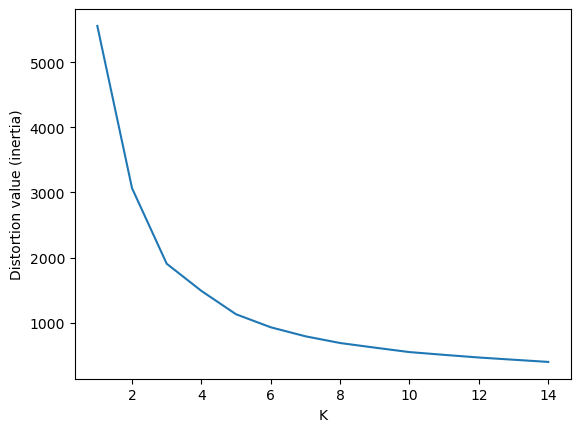

In [28]:
from matplotlib import pyplot as plt

plt.xlabel('K')
plt.ylabel('Distortion value (inertia)')
plt.plot(k_range,list_dist)
plt.show()

### K DEĞERİ DİRSEK METHODUNDA 5 OLMASI GEREKTİĞİNİ GÖZLEMLEDİK...

##### STEP 3 :  model oluşturalım sonra clustering operasyonunu uygulayalım. 


In [29]:
model = KMeans(n_clusters=5)
y_predicted = model.fit_predict(df_2014[['X_scaled','Y_scaled']])
y_predicted

array([4, 1, 1, ..., 1, 0, 1])

In [30]:
df_2014['cluster'] = y_predicted
df_2014

# clusterlar geldi.kümeleme yaptık.

,Dates,Category,X,Y,X_scaled,Y_scaled,cluster
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397,4
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894,1
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952,1
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,4
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,4
...,...,...,...,...,...,...,...
102345,2014,OTHER OFFENSES,-122.387235,37.719401,0.851793,0.101571,0
102346,2014,WARRANTS,-122.387235,37.719401,0.851793,0.101571,0
102347,2014,FRAUD,-122.418382,37.783258,0.641908,0.672007,1
102348,2014,NON-CRIMINAL,-122.413652,37.728320,0.673778,0.181249,0


### STEP 4: ML MODELİNİ HARİTA ÜZERİNDE GÖSTERELİM.

In [31]:
import plotly.express as px 

In [35]:
# y enlem ,x boylam.
figure = px.scatter_mapbox(df_2014,lat='Y',lon='X',
                           center = dict(lat=37.8,lon =-122.4),#harita merkezi
                           zoom = 9,
                           opacity = .9,#çok belirglin mi değil mi harita görüntüsü
                           mapbox_style = 'open-street-map',
                           color = 'cluster',# clustera göre renklendir.
                           title = 'San Francisco Crime Districts',
                           width =1100,
                           height = 700,
                           hover_data = ['cluster','Category','Y','X']
                           #herhangi bir yer üzerinde durrusam o suçla ilgili detay
                            # bilgi geliyor.bu sütunlardan oluşan bilgi,ayrıntı..
                          )
figure.show()

### STEP 5 : bu haritayı  bir html dosyasına export edicez kayıt edicez.  ve jupyterden bağımsız bir şekilde nasıl aççacağımıza bakalım.

In [36]:
import plotly
plotly.offline.plot(figure,filename='maptest.html',auto_open=True)

# figure nesnesini verdik,dosya ismii verdik.bulunduğumuz dizine koyacak 
  # belirtmediğimiz için.

'maptest.html'

In [38]:
help(px.scatter_mapbox)

# methodları anlatan yazıya erişiriz.scatter_mapbox için.

Help on function scatter_mapbox in module plotly.express._chart_types:

scatter_mapbox(data_frame=None, lat=None, lon=None, color=None, text=None, hover_name=None, hover_data=None, custom_data=None, size=None, animation_frame=None, animation_group=None, category_orders=None, labels=None, color_discrete_sequence=None, color_discrete_map=None, color_continuous_scale=None, range_color=None, color_continuous_midpoint=None, opacity=None, size_max=None, zoom=8, center=None, mapbox_style=None, title=None, template=None, width=None, height=None) -> plotly.graph_objs._figure.Figure
        In a Mapbox scatter plot, each row of `data_frame` is represented by a
        symbol mark on a Mapbox map.
        
    Parameters
    ----------
    data_frame: DataFrame or array-like or dict
        This argument needs to be passed for column names (and not keyword
        names) to be used. Array-like and dict are transformed internally to a
        pandas DataFrame. Optional: if missing, a DataFrame get